In [1]:
%config InlineBackend.figure_format='retina'

In [2]:
from copy import deepcopy
import warnings
warnings.filterwarnings("ignore")

In [4]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

# Загрузка данных

## Сенсоры

In [33]:
Data = pd.read_csv("../Probe_Data/SensorsData_FebMarMay.csv", index_col=0).iloc[:,:-1]
Data.index = Data.index.astype("datetime64[ns]")

## Остановки

In [35]:
# StopLogs data

stops_data = pd.read_csv("../Probe_Data/Jan_to_Jun_StopLogs.csv")
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

# Предобработка

## Fill NA

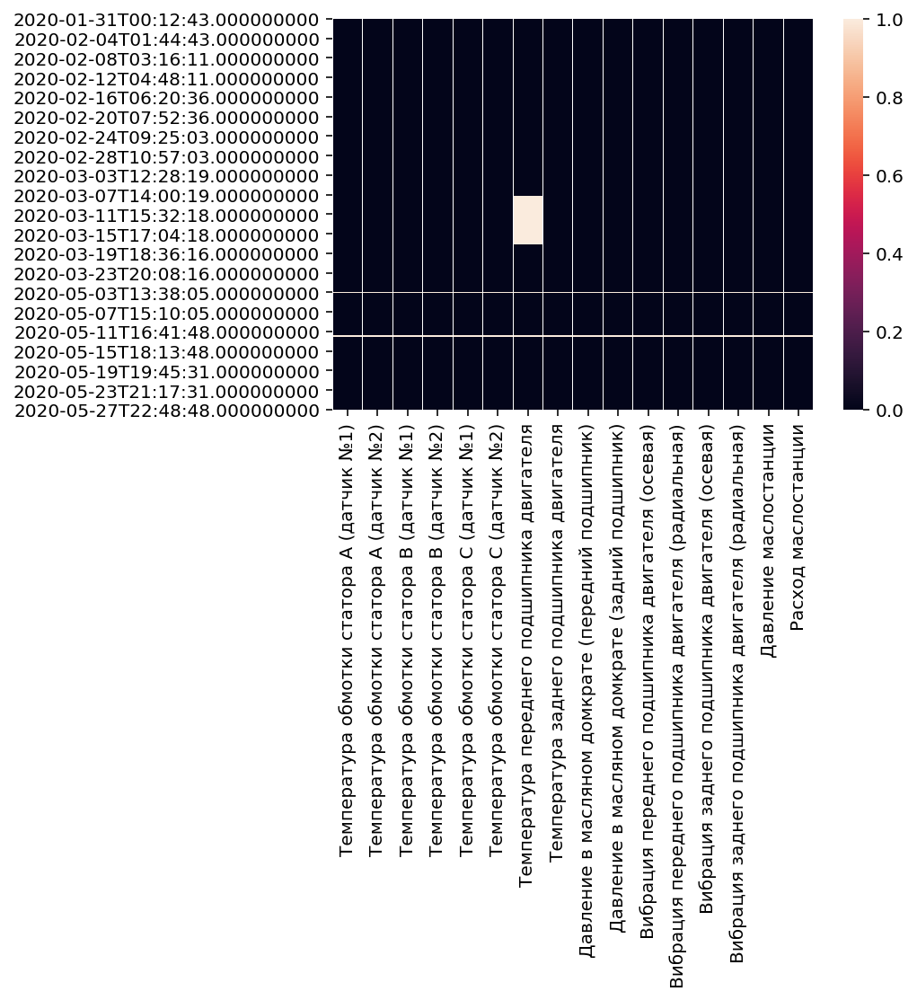

In [36]:
sns.heatmap(Data.isna())

In [37]:
Data.dropna(how='all', inplace=True)

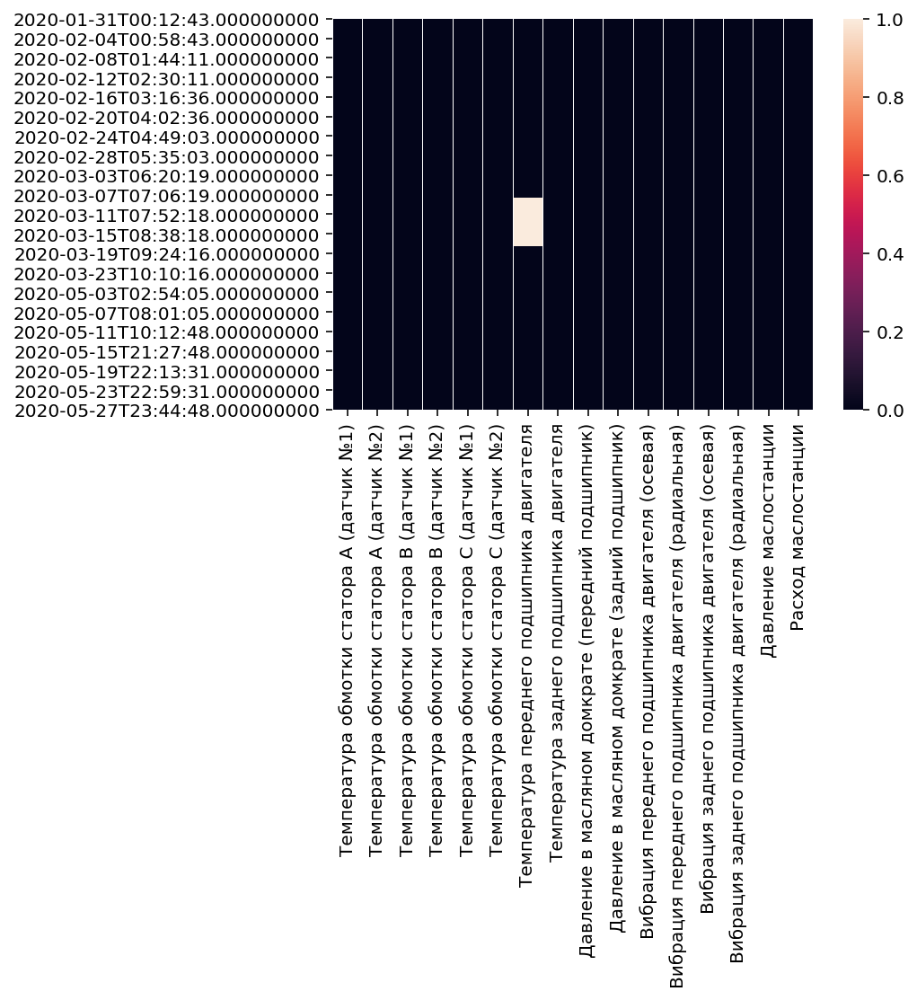

In [38]:
sns.heatmap(Data.isna())

In [39]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer()
Data = pd.DataFrame(imputer.fit_transform(Data), index=Data.index, columns=Data.columns)

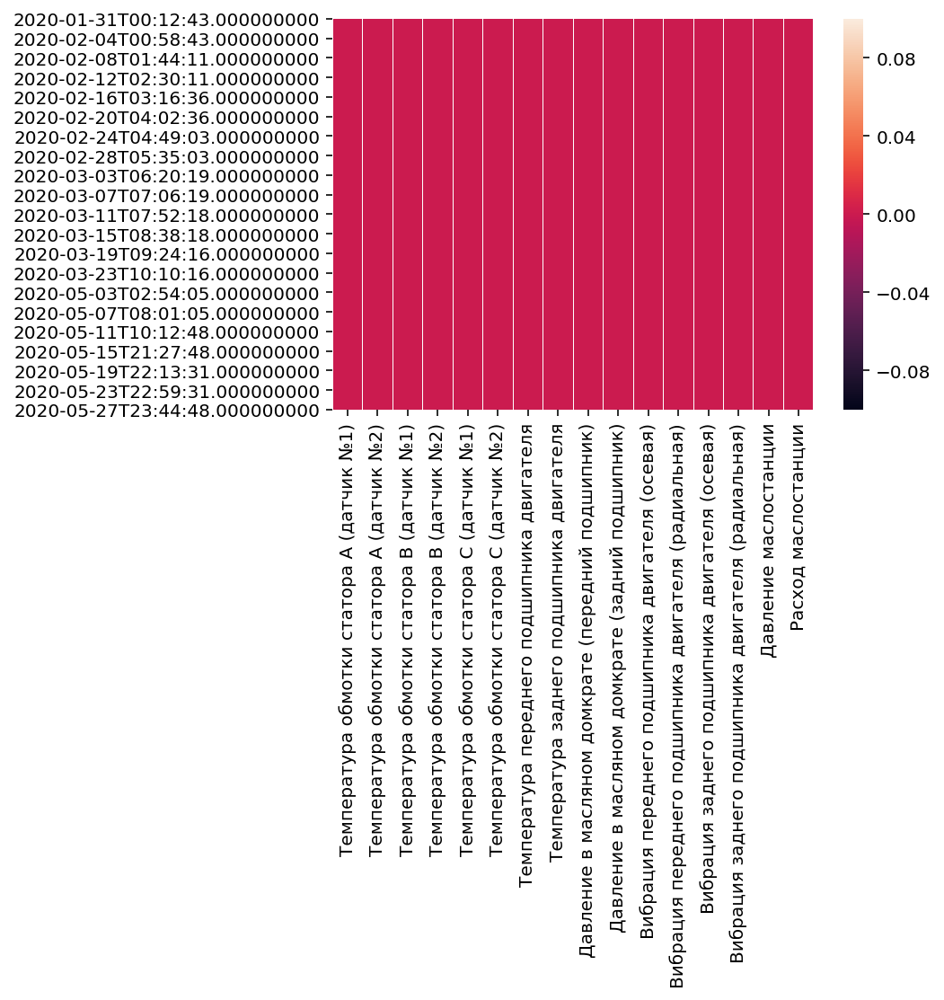

In [40]:
sns.heatmap(Data.isna())

## Таргет

In [41]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in stops_data[np.invert(stops_data.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [42]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 5.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 5.0)] = 1

In [43]:
def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = deepcopy(Data.target.shift(-delta, fill_value=0).values)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

In [44]:
# Смещаем на 120 шагов (здесь минут) = 2 часа

Data = SetShiftTarget(Data, 120)

## Init Features

In [45]:
ValData = deepcopy(Data[Data.index < "2020-05"])
ExamData = deepcopy(Data[Data.index >= "2020-05"])

In [46]:
X = ValData.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y = ValData['shift_target']

Exam_X = ExamData.drop(['target', 'target_dscr', 'shift_target'], axis=1)
Exam_y = ExamData['shift_target']

## Нормализация

In [47]:
from sklearn.preprocessing import StandardScaler

# Normalize X
ss = StandardScaler()

X = pd.DataFrame(ss.fit_transform(X),
                 index=X.index,
                 columns=X.columns)

Exam_X = pd.DataFrame(ss.fit_transform(Exam_X),
                      index=Exam_X.index,
                      columns=Exam_X.columns)

## Feature Creating : the Multiplication method

The multiplication method is proposed in this work to create more heterogeneous image-like data representation. These heterogeneous patterns in the image representation can help the creation of different filters by the CNN model, increasing its ability to correctly classify the data as normal or faulty. Given the example $d = \{f_1, f_2, …, f_n \}$, the transformed example $D_m$ is given by a matrix created by the multiplication of the $f_i$ features by the whole example $d$, as presented by Equation 5:

$$\begin{equation*}D_{m}=\begin{bmatrix}{f_{1} \cdot f_{1}} & {f_{1} \cdot f_{2}} & {\cdots} & {f_{1} \cdot f_{n}} \\ {f_{2} \cdot f_{1}} & {f_{2} \cdot f_{2}} & {\ddots} & {f_{2} \cdot f_{n}} \\ {\vdots} & {\vdots} & {\ddots} & {\vdots} \\ {f_{n} \cdot f_{1}} & {f_{n} \cdot f_{2}} & {\cdots} & {f_{n} \cdot f_{n}}\end{bmatrix} \tag{5}\end{equation*}$$

In [48]:
from tqdm.notebook import tqdm
from sklearn.preprocessing import MinMaxScaler

def get_X_for_CNN(X):
    
    X_vals = X.values.reshape(*X.shape, 1)
    mms = MinMaxScaler()
    X_to_CNN = np.array([mms.fit_transform(ex @ ex.T) for ex in tqdm(X_vals)], dtype=float)
    
    return X_to_CNN.reshape(-1, 1, *X_to_CNN.shape[1:])

In [49]:
from copy import deepcopy

X_to_CNN = get_X_for_CNN(X)
y_to_CNN = deepcopy(y.values.astype(int))

Exam_X_to_CNN = get_X_for_CNN(Exam_X)
Exam_y_to_CNN = deepcopy(Exam_y.values.astype(int))

# Создание модели

In [50]:
import torch
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
from torchvision import transforms
from IPython.display import clear_output

In [51]:
from torch.utils.data import DataLoader, TensorDataset
from torch.utils.data import Dataset as BaseDataset

## Dataset

In [52]:
from sklearn.model_selection import train_test_split

# Validation
#==================================================
tensor_x = torch.Tensor(X_to_CNN) 
tensor_y = torch.Tensor(y_to_CNN).long()

X_train, X_test, y_train, y_test = train_test_split(tensor_x,
                                                    tensor_y,
                                                    test_size=0.3,
                                                    random_state=42,
                                                    shuffle=False)

Train_dataset = TensorDataset(X_train, y_train)
Train_dataloader = DataLoader(Train_dataset)

Test_dataset = TensorDataset(X_test, y_test)
Test_dataloader = DataLoader(Test_dataset)
#==================================================

# Exam
#==================================================
exam_tensor_x = torch.Tensor(Exam_X_to_CNN) 
exam_tensor_y = torch.Tensor(Exam_y_to_CNN)

Exam_dataset = TensorDataset(exam_tensor_x, exam_tensor_y)
Exam_dataloader = DataLoader(Exam_dataset)
#==================================================

## Model

In [56]:
# input ->
# 4 Conv 3x3 -> ReLU ->
# 8 Conv 3x3 -> ReLU ->
# 16 Conv 3x3 -> ReLU -> maxpool ->
# ravel -> Linear -> LogSoftmax




class ConvClassifier(nn.Module):
    def __init__(self, image_size=17, channels=1):
        super(ConvClassifier, self).__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(channels, 4, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(4, 8, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(8, 16, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
        )
        self.linear_layers = nn.Sequential(
            nn.Linear((image_size//2) * (image_size//2) * 16, 2),
            nn.LogSoftmax(dim=1))

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(x.size(0), -1)
        x = self.linear_layers(x)
        return x

## Training

In [57]:
def train(network, epochs, learning_rate):
    loss = nn.NLLLoss()
    optimizer = torch.optim.Adam(network.parameters(), lr=learning_rate)
    train_loss_epochs = []
    test_loss_epochs = []
    train_accuracy_epochs = []
    test_accuracy_epochs = []
    try:
        for epoch in range(epochs):
            #===========================================================================================
            losses = []
            accuracies = []
            for X, y in Train_dataloader:
                network.zero_grad()
                prediction = network(X)
                loss_batch = loss(prediction, y)
                losses.append(loss_batch.item())
                loss_batch.backward()
                optimizer.step()
                accuracies.append((np.argmax(prediction.data.numpy(), 1)==y.data.numpy()).mean())
            train_loss_epochs.append(np.mean(losses))
            train_accuracy_epochs.append(np.mean(accuracies))
            #===========================================================================================
            losses = []
            accuracies = []    
            for X, y in Test_dataloader:
                prediction = network(X)
                loss_batch = loss(prediction, y)
                losses.append(loss_batch.item())
                accuracies.append((np.argmax(prediction.data.numpy(), 1)==y.data.numpy()).mean())
            test_loss_epochs.append(np.mean(losses))
            test_accuracy_epochs.append(np.mean(accuracies))
            #===========================================================================================
            clear_output(True)
            print('\rEpoch {0}... (Train/Test) NLL: {1:.3f}/{2:.3f}\tAccuracy: {3:.3f}/{4:.3f}'.format(
                        epoch+1, train_loss_epochs[-1], test_loss_epochs[-1],
                        train_accuracy_epochs[-1], test_accuracy_epochs[-1]))
            plt.figure(figsize=(12, 5))
            plt.subplot(1, 2, 1)
            plt.plot(train_loss_epochs, label='Train')
            plt.plot(test_loss_epochs, label='Test')
            plt.xlabel('Epochs', fontsize=16)
            plt.ylabel('Loss', fontsize=16)
            plt.legend(loc=0, fontsize=16)
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(train_accuracy_epochs, label='Train accuracy')
            plt.plot(test_accuracy_epochs, label='Test accuracy')
            plt.xlabel('Epochs', fontsize=16)
            plt.ylabel('Loss', fontsize=16)
            plt.legend(loc=0, fontsize=16)
            plt.grid()
            plt.show()
            
    except KeyboardInterrupt:
        pass

Epoch 21... (Train/Test) NLL: 0.224/0.208	Accuracy: 0.940/0.951


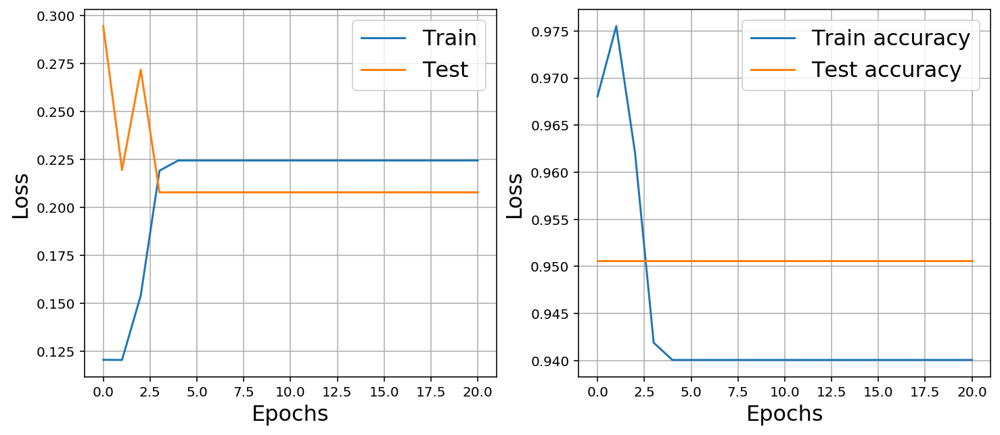

In [59]:
network_clf = ConvClassifier(image_size=16)
train(network_clf, 50, 1e-3)

In [60]:
TrainPreds = []
for x,y in tqdm(Train_dataloader):
    prediction = np.exp(network_clf.forward(x).detach().numpy())
    TrainPreds.append(prediction)
    
TrainPreds = np.array(TrainPreds).reshape(-1,2)

In [61]:
TestPreds = []
for x,y in tqdm(Test_dataloader):
    prediction = np.exp(network_clf.forward(x).detach().numpy())
    TestPreds.append(prediction)
    
TestPreds = np.array(TestPreds).reshape(-1,2)

In [62]:
ExamPreds = []
for x,y in tqdm(Exam_dataloader):
    prediction = np.exp(network_clf.forward(x).detach().numpy())
    ExamPreds.append(prediction)
    
ExamPreds = np.array(ExamPreds).reshape(-1,2)

In [63]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = Data.columns[12]
sens_name_2 = Data.columns[13]

Sens_1 = Data[sens_name_1].values
Sens_2 = Data[sens_name_2].values

# TrainPreds = TrainPreds * max(Sens_1.max(), Sens_2.max())
# TestPreds = TestPreds * max(Sens_1.max(), Sens_2.max())
# ExamPreds = ExamPreds * max(Sens_1.max(), Sens_2.max())

Target = Data.target.values * max(Sens_1.max(), Sens_2.max())
Shifted_Target = Data.shift_target.values * max(Sens_1.max(), Sens_2.max())
Target_DSCR = Data.target_dscr.values


fig = go.Figure()
fig.add_trace(go.Scatter(x=Data.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))

fig.add_trace(
    go.Scatter(x=Data.index, y=Shifted_Target, text=Target_DSCR,
               name="Target"))

fig.add_trace(
    go.Scatter(x=Data.index[:len(TrainPreds)],
               y=TrainPreds[:,1],
               name="Train Preds"))
fig.add_trace(
    go.Scatter(x=Data.index[len(TrainPreds):len(TrainPreds) + len(TestPreds)],
               y=TestPreds[:,1],
               name="Test Preds"))
fig.add_trace(
    go.Scatter(x=Data.index[len(TrainPreds) + len(TestPreds):len(TrainPreds) +
                            len(TestPreds) + len(ExamPreds)],
               y=ExamPreds[:,1],
               name="Exam Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)